![DeepNeuro](https://github.com/QTIM-Lab/DeepNeuro/raw/master/package_resources/logos/DeepNeuro_alt.PNG?raw=true)

# Training A Model with DeepNeuro

In this notebook, you will learn how to train a model using DeepNeuro. With DeepNeuro, you can select from a pre-made model architecture from the deepneuro.models module, and easily configure its hyper-parameters using a Python dictionary. From there, you can train a model while augmenting data on the fly.

Before we begin the tutorial, we of course have to install DeepNeuro. We can do that using the pip (or pip3, if you use Python 3) package manager.

In [ ]:
# Uncomment the following four lines if you are running this notebook in Google Colab
# !apt update
# !apt install -y cmake
# !pip uninstall tensorflow
# !pip install https://github.com/pskrunner14/tensorflow-wheel/releases/download/tf-1.10.0-gpu-avx2-v1.0/tensorflow-1.10.0-cp36-cp36m-linux_x86_64.whl

!pip3 install deepneuro keras

import deepneuro

## Loading Data

Before we get started training a model, we're going to have to have to some data to train, validate, and test on. If you want to learn about data preprocessing and augmentation at length, I encourage to check out the previous tutorial. If you have already generated training data from the previous tutorial (linked here), you can load the HDF5 file you created. Otherwise, you can download that dataset here.

In [1]:
from deepneuro.load.load import load

# If you haven't downloaded the data from the previous tutorials,
# you can do so here.
load('sample_gbm_nifti', output_datapath='./Sample_Data')

'./Sample_Data/TCGA_GBM_NIFTI.zip'

The following code is re-implemented from the "Loading, Preprocessing, and Augmenting Data Using DeepNeuro" tutorial. It will load a DeepNeuro HDF5 file if you created in the previous tutorial, or create a new HDF5 file given the data loaded above.

In [2]:
import os

# If your workstation has multiple GPUs, this code will make sure
# you only use GPU #0 in this Jupyter notebook.
os.environ["CUDA_DEVICE_ORDER"] = "PCI_BUS_ID"
os.environ["CUDA_VISIBLE_DEVICES"] = '0'

from deepneuro.data.data_collection import DataCollection
from deepneuro.preprocessing.signal import ZeroMeanNormalization
from deepneuro.preprocessing.transform import SplitData
from deepneuro.augmentation.augment import Flip_Rotate_2D
from deepneuro.augmentation.subsample import ExtractPatches

training_data_sources = {
    'directories': {
                'Sample_Data/GBM_NIFTI/TRAINING':
                {'input_data': ['*_flair.nii.gz*', '*_t2.nii.gz*', '*_t1.nii.gz', '*_t1Gd.nii.gz'], 
                 'ground_truth': ['*GlistrBoost_ManuallyCorrected.nii.gz']}},
}
validation_data_sources = {
    'directories': {
                'Sample_Data/GBM_NIFTI/VALIDATION':
                {'input_data': ['*_flair.nii.gz*', '*_t2.nii.gz*', '*_t1.nii.gz', '*_t1Gd.nii.gz'], 
                 'ground_truth': ['*GlistrBoost_ManuallyCorrected.nii.gz']}},
}
testing_data_sources = {
    'directories': {
                'Sample_Data/GBM_NIFTI/TESTING':
                {'input_data': ['*_flair.nii.gz*', '*_t2.nii.gz*', '*_t1.nii.gz', '*_t1Gd.nii.gz'], 
                 'ground_truth': ['*GlistrBoost_ManuallyCorrected.nii.gz']}},
}

# If you're lacking on space, you can turn down the patch_multiplier variable.
def load_preprocess_augment(data_sources, output_hdf5, patch_multiplier=200, augment=True, overwrite=False):
    
    if not os.path.exists(output_hdf5) or overwrite:
    
        data_collection = DataCollection(data_sources=data_sources)

        normalization_preprocessor = ZeroMeanNormalization(data_groups=['input_data'],
                                                       normalize_by_channel=True, 
                                                       mask_zeros=True,
                                                       verbose=False)
        one_hot_preprocessor = SplitData(data_groups=['ground_truth'], 
                                         label_splits=[0, 1, 2, 4],
                                         verbose=False)
        data_collection.append_preprocessor([normalization_preprocessor, one_hot_preprocessor])

        if augment:

            # Define patch sampling regions
            def brain_region(data):
                return data['input_data'] != 0

            def roi_region(data):
                return data['ground_truth'][..., 0] != 1

            patch_augmentation = ExtractPatches(patch_shape=(32, 32, 32), 
                                            patch_region_conditions=[[brain_region, .3], [roi_region, .7]], 
                                            data_groups=['input_data', 'ground_truth'])
            flip_augmentation = Flip_Rotate_2D(flip=True, 
                                               rotate=True, 
                                               data_groups=['input_data', 'ground_truth'], 
                                               flip_axis=2)
            data_collection.append_augmentation(flip_augmentation, multiplier=8)
            data_collection.append_augmentation(patch_augmentation, multiplier=patch_multiplier)

        data_collection.write_data_to_file(output_hdf5)
        
    return DataCollection(data_sources={'hdf5': output_hdf5})

training_data = load_preprocess_augment(training_data_sources, 'training.hdf5')
validation_data = load_preprocess_augment(validation_data_sources, 'validation.hdf5')
testing_data = load_preprocess_augment(testing_data_sources, 'testing.hdf5', augment=False)


('Found', 3200, 'cases..')
('Found', 1600, 'cases..')
('Found', 1, 'cases..')


/usr/local/lib/python3.4/dist-packages/tables-3.4.4-py3.4-linux-x86_64.egg/tables/leaf.py:414: PerformanceWarning: The Leaf ``/ground_truth`` is exceeding the maximum recommended rowsize (104857600 bytes);
be ready to see PyTables asking for *lots* of memory and possibly slow
I/O.  You may want to reduce the rowsize by trimming the value of
dimensions that are orthogonal (and preferably close) to the *main*
dimension of this leave.  Alternatively, in case you have specified a
very small/large chunksize, you may want to increase/decrease it.
  PerformanceWarning)
/usr/local/lib/python3.4/dist-packages/tables-3.4.4-py3.4-linux-x86_64.egg/tables/leaf.py:414: PerformanceWarning: The Leaf ``/input_data`` is exceeding the maximum recommended rowsize (104857600 bytes);
be ready to see PyTables asking for *lots* of memory and possibly slow
I/O.  You may want to reduce the rowsize by trimming the value of
dimensions that are orthogonal (and preferably close) to the *main*
dimension of this leav

Notice that we did not apply augmentations to the testing source data. When we run inference on this data, we want it to evaluate the results not in terms of performance on patches, but in terms of the whole-brain segmentation. In the guide below, we will show you how to evaluate performance based on full images stiched together from patched-based segmentations during training.

## Creating a U-Net with DeepNeuro

The most popular architectures for segmentation in 2D and 3D is the U-Net architecture. While many have made modified the U-Net, the principal components have stayed constant: a series of convolutions followed by downsampling operations, concatenated to a sequential series of convolutions followed by upsampling operations.

DeepNeuro allows you to customize many aspects of the U-Net. That may be useful for you in this tutorial, as the 3D U-Net can be quite computationally demanding at large sizes, and you may not have an high-performing GPU to run the full version of the model. We are going to show you how to adjust parameters to create a smaller U-Net that originally proposed, that may be better able to run on your system.

The first thing we're going to do is import the UNet object from DeepNeuro's model library. Then, we define a dictionary of parameters that we can use to modify the model. The parameters we include here are not an exhaustive list of parameters for every model, but will help shrink the model down. In particular, we are going to:

* Reduce the depth of the U-Net from 4 to 3. This means input patches will be reduced from 32x32x32, to 16x16x16, to 8x8x8, and then back up again.
* Cut the number of maximum filters by a factor of 8 at the bottom-most layer. By convention, the lowest-resolution layer in the U-Net  has the most layers, and each layer at higher resolutions has half the number of filters in the previous layer. This means we will have 32, 64, 128, 64, and 32 filters at each of our resolutions.
* In the fashion of the day, we will use batch normalization instead of dropout.

In [3]:
from deepneuro.models.unet import UNet

model_parameters = {'input_shape': (32, 32, 32, 4),
                'output_channels': 4,
                'dropout': 0, 
                'batch_norm': True, 
                'initial_learning_rate': 0.001,
                'cost_function': 'categorical_crossentropy',
                'depth': 3,
                'max_filter': 128}

unet_model = UNet(**model_parameters)

Using TensorFlow backend.


Looks easy enough! We can use some code from https://keras.io/visualization/ to visualize the architecture of a our model in an Jupyter/Colab notebook. You can access the Keras model objects from the UNet object we created via its "model" attribute -- e.g. unet_model.model.

In [ ]:
from IPython.display import SVG
from keras.utils.vis_utils import model_to_dot

SVG(model_to_dot(unet_model.model, show_shapes=True).create(prog='dot', format='svg'))

## Validating Your Network by Overfitting to One Batch

Now that we have a neural network architecture, we will want to have our network learn how to segment on our data. Before we do that, however, we want to make sure that our network is capable of learning at all. 

One method to check this is to see if our data can overfit to one batch. Learning how to correctly segment one batch of data should be an easy task for a neural network with this much capacity. If the loss does not head down on this data, we may have configured our network or preprocessed our data incorrectly.

DeepNeuro makes this easy enough with the fit_one_batch function. We feed in some training parameters, again specified in a dict, and let the model run.

In [ ]:
# This code will make results plotting look nicer in Jupyter/Colab.
%matplotlib inline
import matplotlib.pyplot as plt
plt.rcParams['figure.figsize'] = [15, 15]

one_batch_training_parameters = {'input_groups': ['input_data', 'ground_truth'],
                'training_batch_size': 16,
                'num_epochs': 5,
                'training_steps_per_epoch': 20,
                'callbacks': [],
                'show_results': True}

unet_model.fit_one_batch(training_data, **one_batch_training_parameters)

The loss is going down, and hopefully you can see 'prediction' results starting to match 'ground_truth' results. If your loss stalls, or rises, and the prediction outputs are incomprehsible, there may be a very fundamental problem with the architecture you are implementing. 

Let's move on to our real goal: training on all of the data. Before we get there, however, we will also learn how to add callbacks to our model.

## Model Callbacks and Periodic Testing

Callbacks are events that are processed during model training, such as commands to save out a model to HDF5, commands to output certain model statistics, or commands to adjust certain hyperparameters like learning rates. DeepNeuro allows you to specify Keras-style callbacks, and custom callbacks more appropriate to training on medical imaging datasets. We're going to set up four callbacks:

* `save_model`: Save our trained model into an hdf5 file every epoch.
* `predict_epoch`: Predicts a full volume, in this case from our testing set, every epoch.
* `cyclic_loss`: Applies a cyclical learning rate, which oscillates between a maximum and minimum value, as is said to remove the need for fine-tuning learning rates.

In [6]:
callbacks = ['save_model', # Saves your model every epoch.
             'predict_epoch', # Predicts a full volume every epoch.
             'cyclic_learning_rate',] # Applies cyclical learning rate.

Most of these callbacks are ready-made: simply add their identifier to your list of callbacks, and feed them into your model at training time. Predicting data every epoch, however, requires a bit more paramterization.

Particularly, if we want to predict an entire volume every epoch, we're going have to specify a new DeepNeuro object. This object is called ModelPatchesInference, and will automatically compose a full volume out of individual patches. We can specify parameters for this object with another dict.

In [7]:
from deepneuro.outputs.inference import ModelPatchesInference

periodic_testing_parameters = {'inputs': ['input_data'],
               'batch_size': 20,
               'output_patch_shape': (30, 30, 30, 1),
               'patch_overlaps': 4,
               'verbose': False}

periodic_testing_output = ModelPatchesInference(**periodic_testing_parameters)

Two parameters deserve further investigation here. One is `output_patch_shape`, and the fact that it is smaller than the input shape of the network. We have noticed that, likely to do resampling operations in the U-Net, predictions tend to be highly inaccurate at the edges of generated patches. Setting the `output_patch_shape` to be smaller than the input crops these erroneous predictions out during image reconstruction.

The second parameter, `patch_overlaps` specifies how many patches should be predicted for each voxel in the volume. Setting this parameter to `1` means that each voxel is only predicted once, whereas setting it to `4` means that patches will be generated such that each voxel is the average of at least four different predictions. This method protects against highly-specific prediction misfires that occur only a single patch, and also helps to prevent patch-edge artifacts.

You can learn more about both of these segmentations in the next DeepNeuro tutorial on running inference on trained networks.

In [8]:
trained_model = 'tumor_segmentation_model.hdf5'

training_parameters = {'input_groups': ['input_data', 'ground_truth'],
                'training_batch_size': 16,
                'num_epochs': 100,
                'training_steps_per_epoch': 5,
                'callbacks': callbacks,
                
                # Save model parameters
                'output_model_filepath': trained_model,
                'save_best_only': False,
                
                # Cyclic learning rate parameters
                'cyclic_base_learning_rate': .001,
                'cyclic_max_learning_rate': .006,
                
                # Periodic testing parameters
                'epoch_prediction_dir': './Test_Model_Outputs',
                'epoch_prediction_data_collection': testing_data,
                'epoch_prediction_object': periodic_testing_output,
                'epoch_prediction_batch_size': 1,
                'viz_mode_3d': 'mosaic'}

unet_model.train(training_data, **training_parameters)

Epoch 1/100
5/5 [==============================] - 4s 786ms/step - loss: 1.0401 - categorical_accuracy: 0.8134
Epoch 2/100
5/5 [==============================] - 4s 770ms/step - loss: 0.7957 - categorical_accuracy: 0.9515
Epoch 3/100
5/5 [==============================] - 4s 

This model will train for a while. Once it is finished, or you decide to terminate training time early, we can investigate some of the test outputs it created. DeepNeuro will automatically create a GIF combining all of the predictions at each epoch, so we can see how training changed over time. We can use some Jupyter/Colab code to display that GIF below.

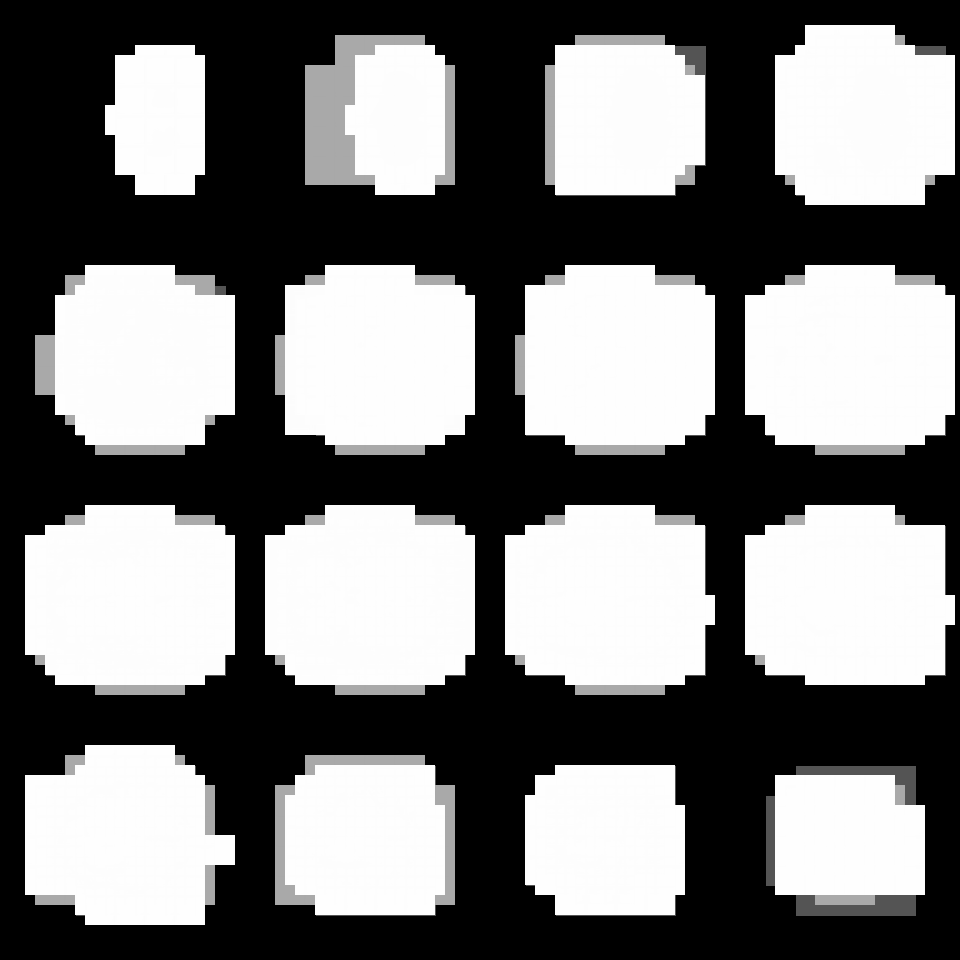

In [9]:
from IPython.display import Image, HTML, display

# Label key for this dataset:
# 0 -- Background
# 1 --  
# 2 --
# 3 --
label_num = 0

with open('./Test_Model_Outputs/epoch_prediction_{}.gif'.format(label_num),'rb') as f:
    display(Image(data=f.read(), format='png'))

Neat! If your training run was anything like mine, the tumor was picked out fairly quickly in the bottom two rows.

Of course, our network will probably not do very well on exterior datasets. We trained it on two patient visits, after all. However, the preprocessing steps you have learned here can easily scale to datasets of hundreds or thousands of patient visits. Models trained from datasets on this scale may have better performance on unseen data, if your chosen dataset is suitably heterogenous.